<a href="https://colab.research.google.com/github/vpavlikha/Asset-Pricing/blob/main/ESG_task.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## **Description**

## Notebook Overview: ESG Task Automation

This notebook is designed to automate the extraction of ESG-related data from corporate reports using a mix of PDF parsing, keyword matching, semantic reasoning, and structured output to Excel.

### Core Functionalities

1. **Report Downloading**
   The notebook includes functions to search for and download 2023 PDF reports such as Annual, ESG, Sustainability, and Governance reports from company websites using DuckDuckGo.

2. **Text Extraction to JSON**
   It converts all pages of each report into text, storing the results in a structured JSON format grouped by file and page.

3. **General Variable Extraction**
    Using defined keywords for each variable, the notebook visually locates relevant data in the PDFs by scouring each page and identifying text chunks where selected words or expressions appear together. These chunks are then highlighted and shown as image snippets for human review. Upon user confirmation, the matched values are written directly into a structured Excel sheet.


4. **Keyword and Embedding-Based Detection**
   For qualitative or hard-to-quantify variables, it uses combinations of keyword logic and text embeddings to decide whether relevant content is present in the reports, even without displaying visual matches.

5. **Converting non EUR currency metrics**

### Key Variables

* `company`: Target company's name
* `folder_path`: Directory where PDF reports are saved
* `variable`: The variable you want to extract (e.g., "Number of Employees")
* `keyword_dict`: A dictionary mapping variable names to keyword groups used for extraction

### Advantages

The approach works seamlessly across multiple types of ESG reports, including annual, sustainability, and governance documents. It combines manual confirmation with automated extraction, allowing for high accuracy while reducing workload. Extracted data is stored in a structured format compatible with Excel, making it easy to integrate into further analysis workflows. The system also employs semantic understanding, enabling it to capture high-level qualitative insights in addition to quantitative values. This flexibility ensures the tool can accommodate a broad range of ESG metrics.

### Potential Improvements

Future enhancements could include batch execution capabilities, enabling the tool to handle multiple companies and variables at once. Improving detection logic (more pattern based) for currencies and numeric patterns would make extractions more robust.


In [ ]:
# %% Libraries

!pip install duckduckgo-search --quiet
!pip install pymupdf

import os
import glob
import requests
from duckduckgo_search import DDGS
import json
import pandas as pd
import fitz  # PyMuPDF
import re
from collections import Counter
import io
import time
from PIL import Image
from IPython.display import display
from duckduckgo_search import DDGS
from openpyxl import load_workbook
from sentence_transformers import SentenceTransformer
from sklearn.metrics.pairwise import cosine_similarity
from sentence_transformers import SentenceTransformer, util

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 27.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.1/24.1 MB 83.8 MB/s eta 0:00:00


In [ ]:
def download_reports_2023(company_name: str, min_pages: int = 10):
    """
    Downloads all 2023 reports (Annual, ESG, Sustainability, Governance, Remuneration)
    for a given company that match specified keywords and meet a minimum page threshold.

    Process:
        - Performs a DuckDuckGo PDF search using relevant keywords for 2023 reports.
        - Filters by filetype, keywords in the title, and page count.
        - Saves qualifying PDFs locally under Reports/<Company_Name>/.
        - Skips short or malformed documents.

    Inputs:
        company_name (str): The name of the company (e.g., "Alleima").
        min_pages (int): Minimum number of pages required to retain a PDF (default is 10).

    Outputs:
        list: File paths of successfully downloaded and validated PDF reports.
    """
    root_folder = "Reports"
    keywords = ["annual", "esg", "sustainability", "governance", "remuneration"]
    company_folder = os.path.join(root_folder, company_name.replace(" ", "_"))
    os.makedirs(company_folder, exist_ok=True)

    query = f"{company_name} (Annual OR ESG OR Sustainability OR Governance  OR Remuneration) Report 2023 site:.com filetype:pdf"
    print(f"🔍 Searching DuckDuckGo for: {query}")

    downloaded_files = []

    with DDGS() as ddgs:
        results = ddgs.text(query, max_results=20)
        for result in results:
            title = result.get("title", "").lower()
            url = result.get("href", "")
            if url.lower().endswith(".pdf") and any(kw in title for kw in keywords) and "report" in title:
                try:
                    response = requests.get(url)
                    response.raise_for_status()

                    # Determine report type based on keyword
                    report_type = next((kw for kw in keywords if kw in title), "report")
                    clean_type = report_type.capitalize()

                    filename = f"{company_name.replace(' ', '_')}_{clean_type}_Report_2023.pdf"
                    filepath = os.path.join(company_folder, filename)

                    with open(filepath, "wb") as f:
                        f.write(response.content)

                    doc = fitz.open(filepath)
                    if len(doc) >= min_pages:
                        print(f"✅ Saved: {filename} ({len(doc)} pages)")
                        downloaded_files.append(filepath)
                    else:
                        print(f"⚠️ Skipped (too short - {len(doc)} pages): {url}")
                        os.remove(filepath)

                except Exception as e:
                    print(f"❌ Error processing {url}: {e}")
                    continue

    if not downloaded_files:
        print("❌ No valid reports found.")
    return downloaded_files


def transform_repot_pdfs_to_json(folder_path: str, company_name: str) -> dict:
    """
    Extracts page-level text from all PDF files in a folder and saves the content
    into a single JSON file named <company_name>_Reports_2023.json.

    Process:
        - Opens each PDF in the folder.
        - Extracts text from each page.
        - Builds a nested dictionary: {pdf_filename: {page_number: page_text}}.
        - Saves the result to a single JSON file in the same folder.

    Inputs:
        folder_path (str): Path to the folder containing the company's PDF reports.
        company_name (str): The company name used to label the output file.

    Outputs:
        dict: Combined nested dictionary with PDF filenames as keys and
              per-page text dictionaries as values.
    """
    if not os.path.isdir(folder_path):
        return {}

    combined_dict = {}
    cleaned_company = company_name.replace(" ", "_")

    for filename in os.listdir(folder_path):
        if filename.lower().endswith(".pdf"):
            pdf_path = os.path.join(folder_path, filename)
            try:
                doc = fitz.open(pdf_path)
                page_dict = {}

                for page_num in range(len(doc)):
                    page = doc.load_page(page_num)
                    text = page.get_text().strip()
                    page_dict[page_num + 1] = text

                combined_dict[filename] = page_dict

            except Exception:
                continue  # Ignore problematic files silently

    output_filename = f"{cleaned_company}_Reports_2023.json"
    output_path = os.path.join(folder_path, output_filename)

    try:
        with open(output_path, "w", encoding="utf-8") as f:
            json.dump(combined_dict, f, ensure_ascii=False, indent=2)
    except Exception:
        pass  # Fail silently

    return combined_dict


In [ ]:
def currency_extraction(company: str, folder_path: str, dominance_ratio: int = 5, currencies=None):
    """
    Identifies and evaluates currency mentions from a company's annual report using pre-extracted JSON text.

    Process:
        - Loads the JSON file generated from PDF extraction.
        - Extracts text specifically from the annual report PDF.
        - Counts occurrences of predefined currency codes.
        - Prints frequency of each currency and determines the dominant one based on a dominance ratio.

    Inputs:
        company (str): Name of the company (e.g., "Alleima").
        folder_path (str): Path to folder containing <company>_Reports_2023.json.
        dominance_ratio (int): Minimum ratio for the top currency to be considered dominant (default = 5).
        currencies (list[str], optional): List of currency codes to detect. Defaults to a standard list.

    Outputs:
        None (prints value counts and determination to console).
        - If a dominant currency is found, it is displayed as selected.
        - If no dominant currency is found, user is advised to manually review.
    """
    if currencies is None:
        currencies = ["SEK", "EUR", "USD", "GBP", "CHF", "CNY", "NOK", "DKK"]

    json_path = os.path.join(folder_path, f"{company}_Reports_2023.json")
    if not os.path.isfile(json_path):
        print(f"❌ JSON not found: {json_path}")
        return

    with open(json_path, "r", encoding="utf-8") as f:
        report_data = json.load(f)

    pdf_name = f"{company}_Annual_Report_2023.pdf"
    if pdf_name not in report_data:
        print(f"❌ '{pdf_name}' not found in JSON data.")
        return

    text = " ".join(report_data[pdf_name].values()).upper()
    pattern = r"\b(" + "|".join(re.escape(curr) for curr in currencies) + r")\b"
    found = re.findall(pattern, text)
    counts = Counter(found)

    if not counts:
        print("❓ No currency mentions found.")
        return

    print(f"\n💱 Currency value counts in {pdf_name}:")
    print(" | ".join([f"{curr}: {count}" for curr, count in counts.items()]))

    sorted_counts = sorted(counts.items(), key=lambda x: x[1], reverse=True)
    top_currency, top_count = sorted_counts[0]
    is_dominant = all(top_count >= dominance_ratio * count for _, count in sorted_counts[1:])

    if is_dominant:
        print(f"✅ Selected currency: **{top_currency}** (dominant)")
    else:
        print(f"⚠️ No dominant currency. Top found: {top_currency} ({top_count})")
        print("👉 Manual review may be needed.")

In [ ]:
def general_variable_extraction(company, folder_path, variable, keyword_dict,vertical_padding=90,             excel_path="Reports/template_answer.xlsx",sheet_name="DataCollectionSheet"):
    """
    Extracts a specified variable (e.g., "Number of Employees") from PDF reports for a given company,
    guided by keyword searches, and writes the value to a structured Excel sheet.

    Process Overview:
    1. Excel Context Lookup
        - Opens the specified Excel sheet.
        - Searches row 6 for a column header matching the `variable` name.
        - If found, prints 'Valid Inputs' (row 7) and 'Example' (row 8) for user guidance.

    2. PDF File Iteration
        - Iterates through all `.pdf` files inside `folder_path`.
        - For each PDF, invokes keyword-based matching to locate target data.

    3. Keyword-Based Visual Matching (get_visual_match_value_for_variable)
        - Converts PDF text to lowercase and checks each page for matches with the provided keywords.
        - Matches can be single terms or combined phrases.
        - Cropped image snippets around matches are displayed using `PyMuPDF` and `Pillow`.
        - The user is prompted to:
            • Enter a value → saves and stops the search
            • Enter 'n'     → skips to the next match
            • Enter 'skip'  → skips the whole PDF and returns 'N'

    4. Excel Writing (write_variable_result_to_excel)
        - If a value is confirmed, it locates the correct row (matching the company) and column (matching the variable).
        - Writes the value directly into the Excel sheet and saves the file.

    5. Termination
        - Stops scanning other PDFs once a value is accepted.
        - If no matches are accepted, defaults to storing 'N'.

    Inputs:
        company (str): Company name (used to match row in Excel).
        folder_path (str): Path to folder containing the company's PDF reports.
        variable (str): Variable name to extract (must match Excel column header in row 6).
        keyword_dict (dict): Dictionary of {variable: [keywords]} used for searching in PDFs.
        excel_path (str): Path to the Excel workbook where results are stored.
        sheet_name (str): Worksheet name where company-variable grid is located.
        vertical_padding (int): Padding for visual image cropping around keyword matches.

    Outputs:
        Writes the matched variable value directly to the Excel cell.
        Also prints match context, inputs, and feedback along the way.
    """

    def print_excel_variable_context(excel_path, sheet_name, variable_name):
        wb = load_workbook(excel_path, read_only=True)
        sheet = wb[sheet_name]
        header_row = 6
        found = False

        for col in range(1, sheet.max_column + 1):
            val = sheet.cell(row=header_row, column=col).value
            if val and str(val).strip().lower() == variable_name.strip().lower():
                valid_input = sheet.cell(row=7, column=col).value
                example = sheet.cell(row=8, column=col).value
                print(f"\n📌 Variable Found: '{variable_name}' in Excel")
                print(f"   🔹 Valid Inputs (row 7): {valid_input}")
                print(f"   🔹 Example (row 8): {example}")
                found = True
                break

        if not found:
            print(f"\n⚠️ Variable '{variable_name}' not found in Excel header.")
        wb.close()

    def get_user_choice():
        """Ensures input() is shown correctly in notebooks like Colab."""
        time.sleep(0.1)
        try:
            return input("→ ").strip().lower()
        except EOFError:
            return "skip"

    def get_visual_match_value_for_variable(pdf_path, variable_name, keyword_dict, vertical_padding=90, dpi=150):
        keywords = keyword_dict.get(variable_name, [])
        if not keywords:
            print(f"⚠️ No keywords defined for '{variable_name}'.")
            return {"value": "N", "variable": variable_name, "page": None, "match_index": None}

        doc = fitz.open(pdf_path)
        matches = []
        keyword_counter = Counter()

        for page_num, page in enumerate(doc, start=1):
            page_text = page.get_text().lower()

            for keyword in keywords:
                if isinstance(keyword, str):
                    rects = page.search_for(keyword.lower(), quads=True)
                    keyword_counter[keyword] += len(rects)
                    for rect in rects:
                        cropped_rect = fitz.Rect(
                            0,
                            rect.rect.y0 - vertical_padding,
                            page.rect.width,
                            rect.rect.y1 + vertical_padding
                        )
                        matches.append({
                            "page": page_num,
                            "page_obj": page,
                            "rect": cropped_rect,
                            "keyword": keyword
                        })

                elif isinstance(keyword, list):
                    if all(term.lower() in page_text for term in keyword):
                        keyword_counter[str(keyword)] += 1
                        y_positions = []
                        for term in keyword:
                            term_rects = page.search_for(term.lower())
                            for r in term_rects:
                                y_positions.append((r.y0, r.y1))
                        if y_positions:
                            top = max(0, min(y[0] for y in y_positions) - vertical_padding)
                            bottom = min(page.rect.height, max(y[1] for y in y_positions) + vertical_padding)
                            dynamic_crop = fitz.Rect(0, top, page.rect.width, bottom)
                        else:
                            dynamic_crop = fitz.Rect(0, 0, page.rect.width, 120)

                        matches.append({
                            "page": page_num,
                            "page_obj": page,
                            "rect": dynamic_crop,
                            "keyword": " & ".join(keyword)
                        })

        total = len(matches)
        print(f"\n🔍 Variable: {variable_name}")
        keyword_summary = ", ".join([f"'{k}' {v} match(es)" for k, v in keyword_counter.items()])
        print(f"🔑 Keywords found: [{keyword_summary}]")
        print(f"📌 Found {total} match(es) across PDF pages.")

        for i, match in enumerate(matches, 1):
            page = match["page_obj"]
            cropped = match["rect"]
            pix = page.get_pixmap(clip=cropped, dpi=dpi)
            img = Image.open(io.BytesIO(pix.tobytes("png")))
            display(img)

            print(f"\n📄 Match {i} of {total} — Page {match['page']} — Keyword: '{match['keyword']}'")
            print("💬 Enter your response:")
            print("  • A number or value (e.g. 3308) → to accept and save")
            print("  • 'n'                           → to skip this match")
            print("  • 'skip'                        → to stop reviewing and return 'N'")

            choice = get_user_choice()
            if choice == "n":
                continue
            elif choice == "skip":
                print("🛑 Skipping all. Returning 'N'.")
                return {"value": "N", "page": match["page"], "match_index": i, "variable": variable_name}
            else:
                return {
                    "value": choice,
                    "page": match["page"],
                    "match_index": i,
                    "variable": variable_name
                }

        print("❌ No match accepted. Returning 'N'.")
        return {"value": "N", "page": None, "match_index": None, "variable": variable_name}

    def write_variable_result_to_excel(excel_path, sheet_name, company, variable, value):
        wb = load_workbook(excel_path)
        sheet = wb[sheet_name]
        header_row = 6
        company_col = 2
        variable_col = None
        company_row = None

        for col in range(1, sheet.max_column + 1):
            val = sheet.cell(row=header_row, column=col).value
            if val and str(val).strip().lower() == variable.strip().lower():
                variable_col = col
                valid_input = sheet.cell(row=7, column=col).value
                example = sheet.cell(row=8, column=col).value
                print(f"\n📥 Writing to Excel:")
                print(f"   🔹 Valid Inputs (row 7): {valid_input}")
                print(f"   🔹 Example (row 8): {example}")
                break

        for row in range(header_row + 1, sheet.max_row + 1):
            val = sheet.cell(row=row, column=company_col).value
            if val and str(val).strip() == company:
                company_row = row
                break

        if not variable_col or not company_row:
            print(f"❌ Could not find cell for {company} and variable '{variable}'")
            return

        sheet.cell(row=company_row, column=variable_col).value = value
        wb.save(excel_path)
        wb.close()
        print(f"✅ Wrote '{value}' for {company} under '{variable}' in Excel.")

    # === START EXECUTION ===
    print_excel_variable_context(excel_path, sheet_name, variable)

    for pdf_file in os.listdir(folder_path):
        if not pdf_file.lower().endswith(".pdf"):
            continue

        pdf_path = os.path.join(folder_path, pdf_file)
        print(f"\n📘 Processing PDF: {pdf_file}")

        result = get_visual_match_value_for_variable(
            pdf_path=pdf_path,
            variable_name=variable,
            keyword_dict=keyword_dict,
            vertical_padding=vertical_padding,
            dpi=150
        )

        value = result.get("value")
        if value and value != "N":
            write_variable_result_to_excel(
                excel_path=excel_path,
                sheet_name=sheet_name,
                company=company,
                variable=variable,
                value=value
            )
            break  # ✅ Stop at first confirmed value


In [ ]:
def semantic_variable_detection_all_reports(company, variable, keyword_dict, context_window=10, threshold=0.7):
    """
    Determines whether a company's reports mention a target variable based on keyword context and semantic similarity.

    Process:
    1. Automatically loads the company’s reports from JSON:
       'Reports/{company}/{company}_Reports_2023.json'.
    2. Iterates through all reports (PDFs) stored in the JSON:
       - For each page's text:
         • Looks for keyword hits based on lists defined in `keyword_dict`.
         • If all terms in a keyword group are present, the surrounding text is collected.
         • For individual keyword terms, short context windows are extracted.
    3. Combines all matched snippets into one block of text.
    4. Embeds both:
       • The combined match text
       • The variable name
    5. Computes cosine similarity between the variable and the text.
    6. Classifies each report as:
       - "YES" if similarity ≥ threshold
       - "NO" otherwise

    Inputs:
    - company (str): Company name (e.g. "Alleima")
    - variable (str): Variable label you're checking for (e.g. "Board ESG responsibility")
    - keyword_dict (dict): Dictionary like {variable_name: [[...terms...], ...]}
    - context_window (int): Words before/after to extract for individual keyword matches (default 10)
    - threshold (float): Cosine similarity threshold for classifying as "YES" (default 0.7)

    Output:
    - List of dictionaries, one per PDF:
      [
        {
            "report": "<pdf_file_name>",
            "score": <cosine_similarity>,
            "decision": "YES" or "NO",
            "context": "<truncated match text>"
        },
        ...
      ]
    """

    # Construct the default JSON path
    cleaned = company.replace(" ", "_")
    json_path = os.path.join("Reports", cleaned, f"{cleaned}_Reports_2023.json")

    if not os.path.exists(json_path):
        print(f"❌ JSON not found: {json_path}")
        return []

    with open(json_path, "r", encoding="utf-8") as f:
        all_reports = json.load(f)

    model = SentenceTransformer("all-MiniLM-L6-v2")
    keywords = keyword_dict.get(variable, [])
    if not keywords:
        print(f"⚠️ No keywords for variable '{variable}'")
        return []

    results = []

    for pdf_name, page_dict in all_reports.items():
        matches = []

        for page_num, text in page_dict.items():
            text_lower = text.lower()
            words = text_lower.split()

            for keyword in keywords:
                if isinstance(keyword, str):
                    for m in re.finditer(re.escape(keyword.lower()), text_lower):
                        start = max(0, len(re.findall(r'\w+', text_lower[:m.start()])))
                        snippet = " ".join(words[max(0, start - context_window): start + context_window])
                        matches.append(snippet)

                elif isinstance(keyword, list):
                    if all(term.lower() in text_lower for term in keyword):
                        positions = []
                        for term in keyword:
                            match = re.search(re.escape(term.lower()), text_lower)
                            if match:
                                positions.append((match.start(), match.end()))
                        if positions:
                            start_pos = min(p[0] for p in positions)
                            end_pos = max(p[1] for p in positions)
                            grouped_snippet = text_lower[start_pos:end_pos + 1]
                            matches.append(grouped_snippet)

        if not matches:
            print(f"📄 {pdf_name}: No keyword matches found.")
            results.append({
                "report": pdf_name,
                "score": 0.0,
                "decision": "NO",
                "context": ""
            })
            continue

        full_context = " ".join(matches)
        emb_context = model.encode(full_context, convert_to_tensor=True)
        emb_var = model.encode(variable, convert_to_tensor=True)
        score = float(util.cos_sim(emb_var, emb_context)[0][0])
        decision = "YES" if score >= threshold else "NO"

        print(f"\n📘 Report: {pdf_name}")
        print(f"🧠 Similarity: {score:.3f} → {decision}")

        results.append({
            "report": pdf_name,
            "score": score,
            "decision": decision,
            "context": full_context[:1000]
        })

    return results

In [ ]:
def convert_currency_columns_to_eur(excel_path, sheet_name, variables, currency_column,    exchange_rates, save_as):
    """
    Converts values in specified Excel columns to EUR based on provided exchange rates.

    Inputs:
        excel_path (str): Path to the Excel file.
        sheet_name (str): Sheet name to read from.
        variables (list): List of column headers (variables) to convert.
        currency_column (str): Name of the column containing currency codes (e.g. "SEK", "USD").
        exchange_rates (dict): Dictionary of {currency_code: rate_to_EUR}.
        save_as (str): Optional path to save the updated Excel file.

    Output:
        pd.DataFrame: DataFrame with values converted to EUR.
    """
    if exchange_rates is None:
        exchange_rates = {
            "EUR": 1,
            "SEK": 10.502,
            "CAD": 1.4605,
            "USD": 1.12,
            "DKK": 7.47,
            "CHF": 1.0855,
            "GBP": 0.847,
            "NOK": 9.8438,
            "ISK": 135.45
        }

    df = pd.read_excel(excel_path, sheet_name=sheet_name, header=5)

    for var in variables:
        if var not in df.columns:
            print(f"⚠️ Column '{var}' not found. Skipping.")
            continue

        for idx, row in df.iterrows():
            value = row.get(var)
            currency = row.get(currency_column)

            try:
                if pd.isna(value) or currency not in exchange_rates:
                    continue

                # Remove commas and convert
                numeric_value = float(str(value).replace(",", "").replace(" ", ""))
                rate_to_eur = exchange_rates[currency]
                eur_value = numeric_value / rate_to_eur

                df.at[idx, var] = round(eur_value, 2)
            except Exception as e:
                print(f"❌ Error converting at row {idx}, var '{var}': {e}")

    if save_as:
        df.to_excel(save_as, index=False)

    return df


In [ ]:
company_name = "Alleima"
path = f'Reports/{company_name}/'
json_path = f'Reports/{company_name}/{company_name}_Reports_2023.json'

#download_reports_2023(company_name)
transform_repot_pdfs_to_json(path, company_name)
currency_extraction(company_name, path)


💱 Currency value counts in Alleima_Annual_Report_2023.pdf:
SEK: 323 | USD: 8 | EUR: 6 | CHF: 4 | CNY: 4 | GBP: 4 | NOK: 2
✅ Selected currency: **SEK** (dominant)



📘 Processing: integrated-annual-report-2023_eng.pdf

🔍 Variable: Sales
🔑 Keywords: ['['Sales', 'Year']' 24 match(es)]
📌 Found 24 match(es) across pages.


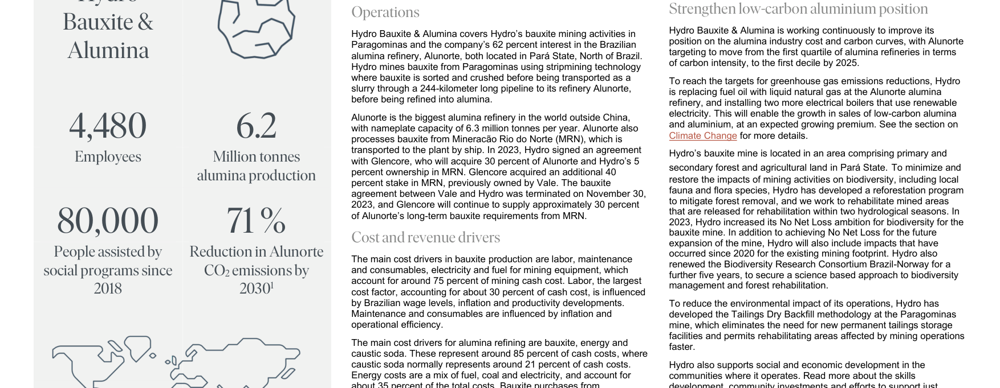


📄 Match 1 of 24 — Page 12 — Keyword: 'Sales & Year'
💬 Enter your response:
  • A number or value (e.g. 3308) → to accept and save
  • 'n'                           → to skip this match
  • 'skip'                        → to stop reviewing matches and mark as 'N'
→ 193619


In [ ]:
variable_name = "Sales (MEUR 20xx YE)"
keywords = {variable_name: [["Sales", "Year"], ["Revenue", "Year"]]}

general_variable_extraction(company_name, path, variable_name, keywords)


📘 Processing: integrated-annual-report-2023_eng.pdf

🔍 Variable: Targets Associated with Environment
🔑 Keywords: ['['emission', 'reduction', 'targets']' 18 match(es), '['climate', 'ambitions']' 16 match(es), '['sustainability', 'goals']' 9 match(es), '['targets', 'environmental performance']' 2 match(es), '['net zero', 'goal']' 1 match(es), '['carbon', 'neutrality', 'target']' 3 match(es)]
📌 Found 49 match(es) across pages.


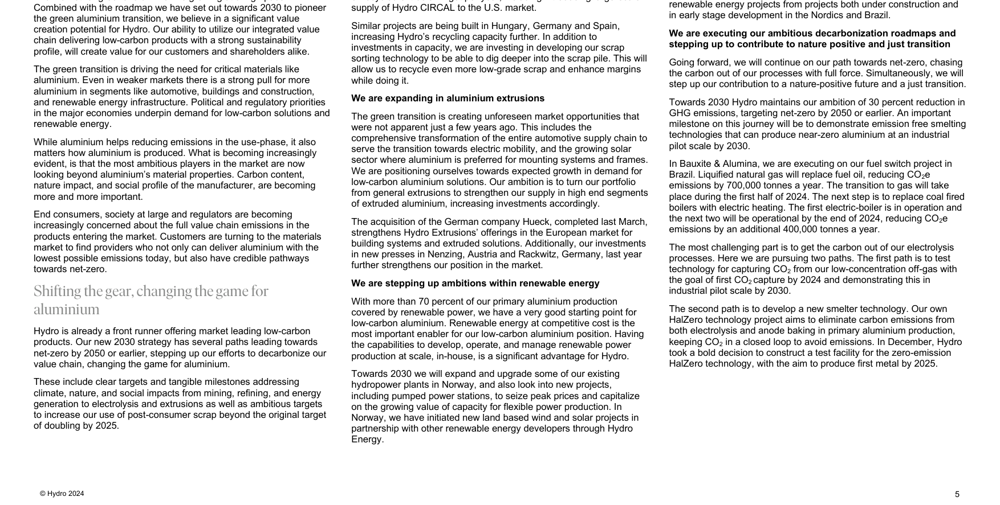


📄 Match 1 of 49 — Page 5 — Keyword: 'emission & reduction & targets'
💬 Enter your response:
  • A number or value (e.g. 3308) → to accept and save
  • 'n'                           → to skip this match
  • 'skip'                        → to stop reviewing matches and mark as 'N'
→ Y


In [ ]:
variable_name = "Targets associated with Environmental Performance"
keywords = {variable_name: [["targets", "environmental performance"], ["sustainability", "goals"], ["emission", "reduction", "targets"], ["carbon", "neutrality", "target"], ["net zero", "goal"], ["climate", "ambitions"]]}

general_variable_extraction(company_name, path, variable_name, keywords)

In [ ]:
variable_name = "Total Energy Consumption (GJ)"

In [ ]:
variable_name = "Disclosure of raw material consumption"
keywords = {variable_name: ["raw material consumption" ]} # "raw material", "raw materials"

general_variable_extraction(company_name, path, variable_name, keywords)


📘 Processing: integrated-annual-report-2023_eng.pdf

🔍 Variable: Targets Efficient Use of Resources
🔑 Keywords: ['['targets', 'resource', 'use']' 24 match(es), '['sustainable', 'resource', 'management']' 11 match(es), '['efficiency', 'targets']' 10 match(es), '['efficient', 'use', 'of', 'resources']' 3 match(es)]
📌 Found 48 match(es) across pages.


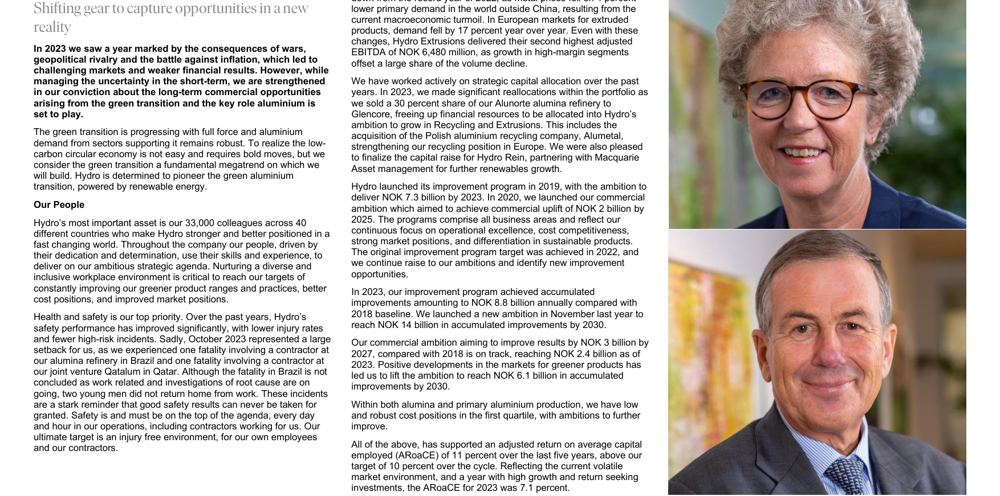


📄 Match 1 of 48 — Page 4 — Keyword: 'targets & resource & use'
💬 Enter your response:
  • A number or value (e.g. 3308) → to accept and save
  • 'n'                           → to skip this match
  • 'skip'                        → to stop reviewing matches and mark as 'N'


In [ ]:
variable_name = "Targets associated with Efficient use of Resources"
keywords = {variable_name: [["efficient", "use", "of", "resources"], ["efficiency", "targets"], ["targets", "resource", "use"], ["sustainable", "resource", "management"], ["resource", "optimization", "goals"]]}

general_variable_extraction(company_name, path, variable_name, keywords)


📘 Processing: Elkem_Annual_Report_2023.pdf

🔍 Variable: Total Scope 1 and 2 Emissions
🔑 Keywords: ['['scope 1', 'scope 2', 'emissions']' 5 match(es), '['total', 'scope 1 and 2']' 1 match(es), '['ghg emissions', 'scope 1', 'scope 2']' 3 match(es), '['greenhouse gas emissions', 'scope 1', 'scope 2']' 1 match(es)]
📌 Found 10 match(es) across pages.


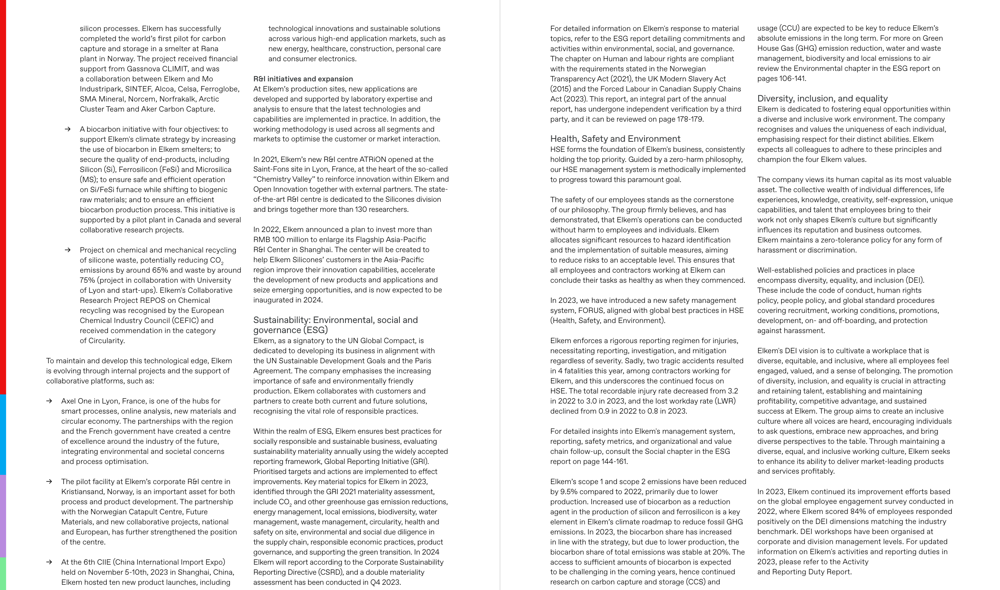


📄 Match 1 of 10 — Page 26 — Keyword: 'scope 1 & scope 2 & emissions'
💬 Enter your response:
  • A number or value (e.g. 3308) → to accept and save
  • 'n'                           → to skip this match
  • 'skip'                        → to stop reviewing matches and mark as 'N'
→ n


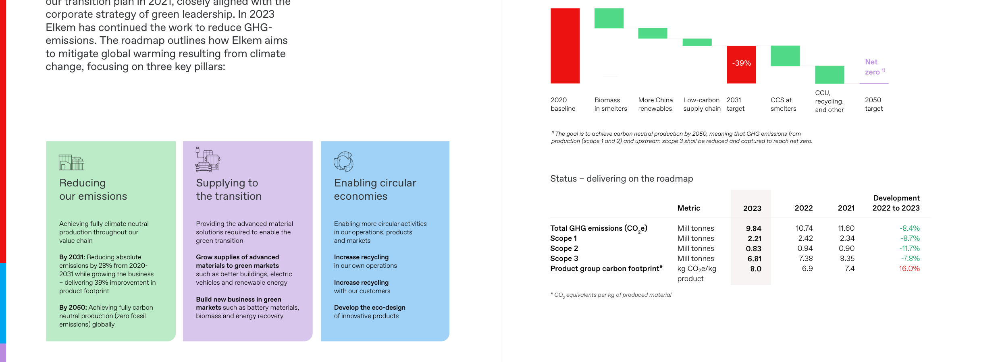


📄 Match 2 of 10 — Page 45 — Keyword: 'scope 1 & scope 2 & emissions'
💬 Enter your response:
  • A number or value (e.g. 3308) → to accept and save
  • 'n'                           → to skip this match
  • 'skip'                        → to stop reviewing matches and mark as 'N'
→ 3040000

📘 Processing: Elkem_Sustainability_Report_2023.pdf

🔍 Variable: Total Scope 1 and 2 Emissions
🔑 Keywords: ['['scope 1', 'scope 2', 'emissions']' 3 match(es), '['total', 'scope 1 and 2']' 2 match(es), '['greenhouse gas emissions', 'scope 1', 'scope 2']' 1 match(es), '['location-based', 'scope 2']' 1 match(es), '['ghg emissions', 'scope 1', 'scope 2']' 1 match(es)]
📌 Found 8 match(es) across pages.


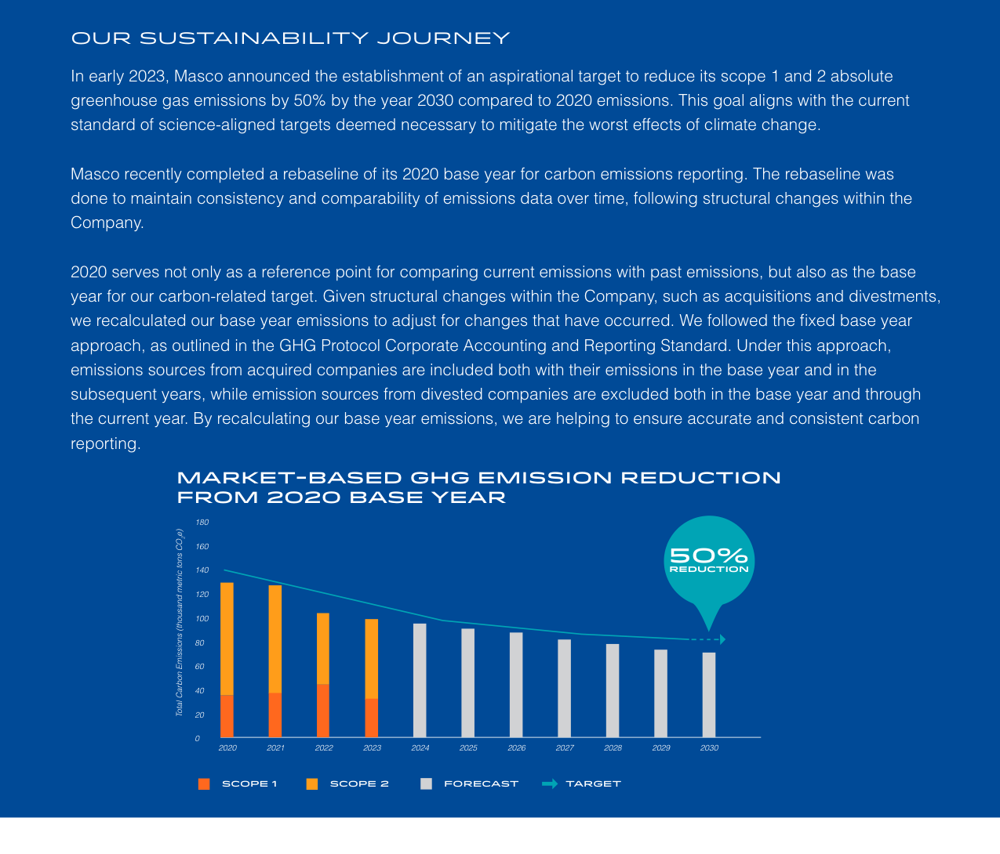


📄 Match 1 of 8 — Page 22 — Keyword: 'scope 1 & scope 2 & emissions'
💬 Enter your response:
  • A number or value (e.g. 3308) → to accept and save
  • 'n'                           → to skip this match
  • 'skip'                        → to stop reviewing matches and mark as 'N'
→ skip
🛑 Skipped by user. Setting value to 'N'.


In [ ]:
variable_name = "Total Scope 1 and Scope 2 Emissions (kilotonnes)"
keywords = {variable_name: [["scope 1", "scope 2", "emissions"], ["total", "scope 1 and 2"], ["greenhouse gas emissions", "scope 1", "scope 2"], ["location-based", "scope 2"], ["ghg emissions", "scope 1", "scope 2"]]}

general_variable_extraction(company_name, path, variable_name, keywords)


📘 Processing: Elkem_Annual_Report_2023.pdf

🔍 Variable: Board Responsibility for ESG Performance
🔑 Keywords: ['['board of directors', 'environmental', 'social', 'performance']' 9 match(es), '['governance', 'environmental', 'social']' 18 match(es), '['ceo', 'esg', 'responsibility']' 6 match(es), '['ceo', 'sustainability', 'oversight']' 1 match(es)]
📌 Found 34 match(es) across pages.


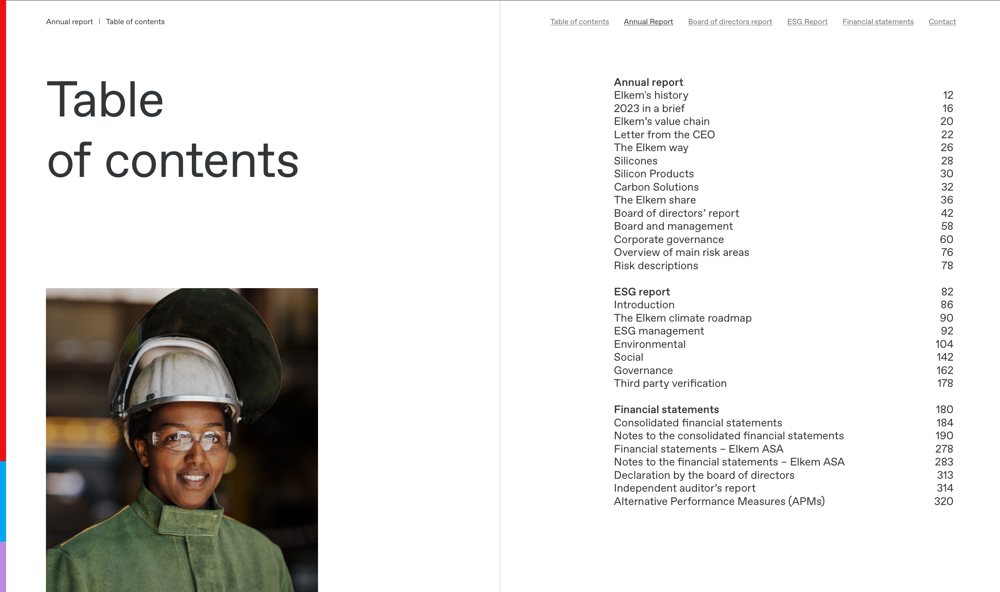


📄 Match 1 of 34 — Page 3 — Keyword: 'board of directors & environmental & social & performance'
💬 Enter your response:
  • A number or value (e.g. 3308) → to accept and save
  • 'n'                           → to skip this match
  • 'skip'                        → to stop reviewing matches and mark as 'N'
→ n


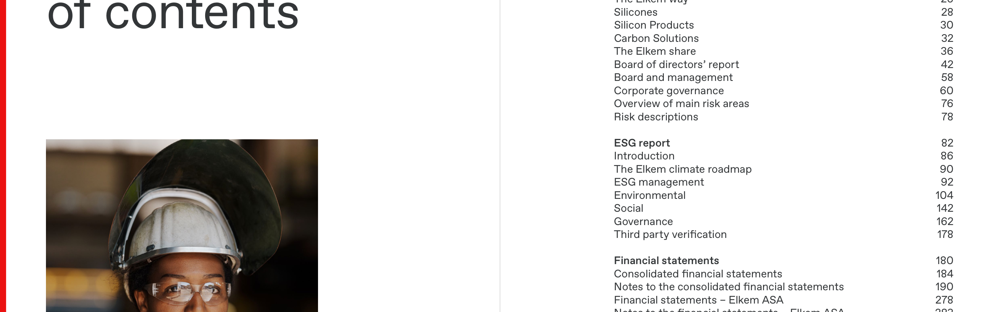


📄 Match 2 of 34 — Page 3 — Keyword: 'governance & environmental & social'
💬 Enter your response:
  • A number or value (e.g. 3308) → to accept and save
  • 'n'                           → to skip this match
  • 'skip'                        → to stop reviewing matches and mark as 'N'
→ n


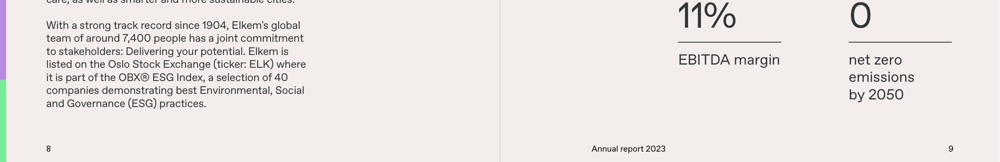


📄 Match 3 of 34 — Page 4 — Keyword: 'governance & environmental & social'
💬 Enter your response:
  • A number or value (e.g. 3308) → to accept and save
  • 'n'                           → to skip this match
  • 'skip'                        → to stop reviewing matches and mark as 'N'
→ n


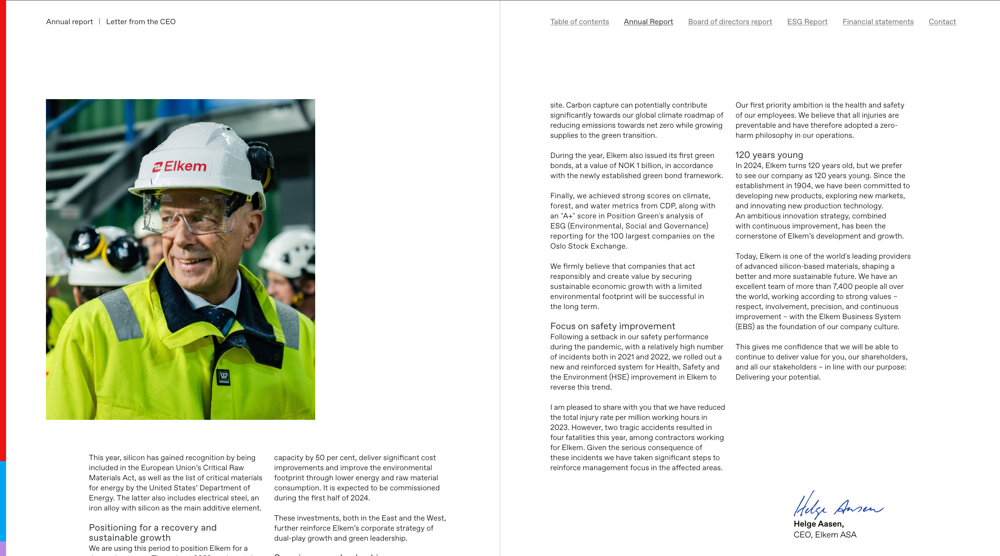


📄 Match 4 of 34 — Page 12 — Keyword: 'board of directors & environmental & social & performance'
💬 Enter your response:
  • A number or value (e.g. 3308) → to accept and save
  • 'n'                           → to skip this match
  • 'skip'                        → to stop reviewing matches and mark as 'N'
→ n


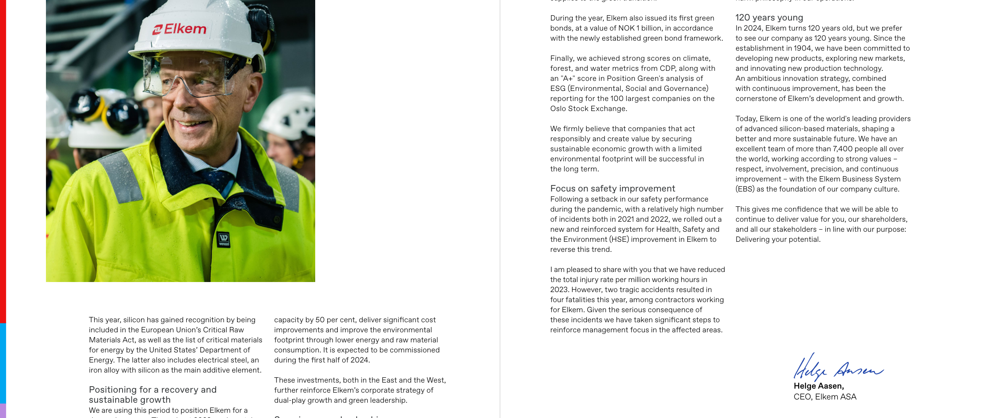


📄 Match 5 of 34 — Page 12 — Keyword: 'governance & environmental & social'
💬 Enter your response:
  • A number or value (e.g. 3308) → to accept and save
  • 'n'                           → to skip this match
  • 'skip'                        → to stop reviewing matches and mark as 'N'
→ Y

📘 Processing: Elkem_Sustainability_Report_2023.pdf

🔍 Variable: Board Responsibility for ESG Performance
🔑 Keywords: ['['board oversight', 'sustainability']' 2 match(es), '['chief executive officer', 'esg']' 1 match(es), '['governance', 'environmental', 'social']' 2 match(es), '['board of directors', 'environmental', 'social', 'performance']' 1 match(es)]
📌 Found 6 match(es) across pages.


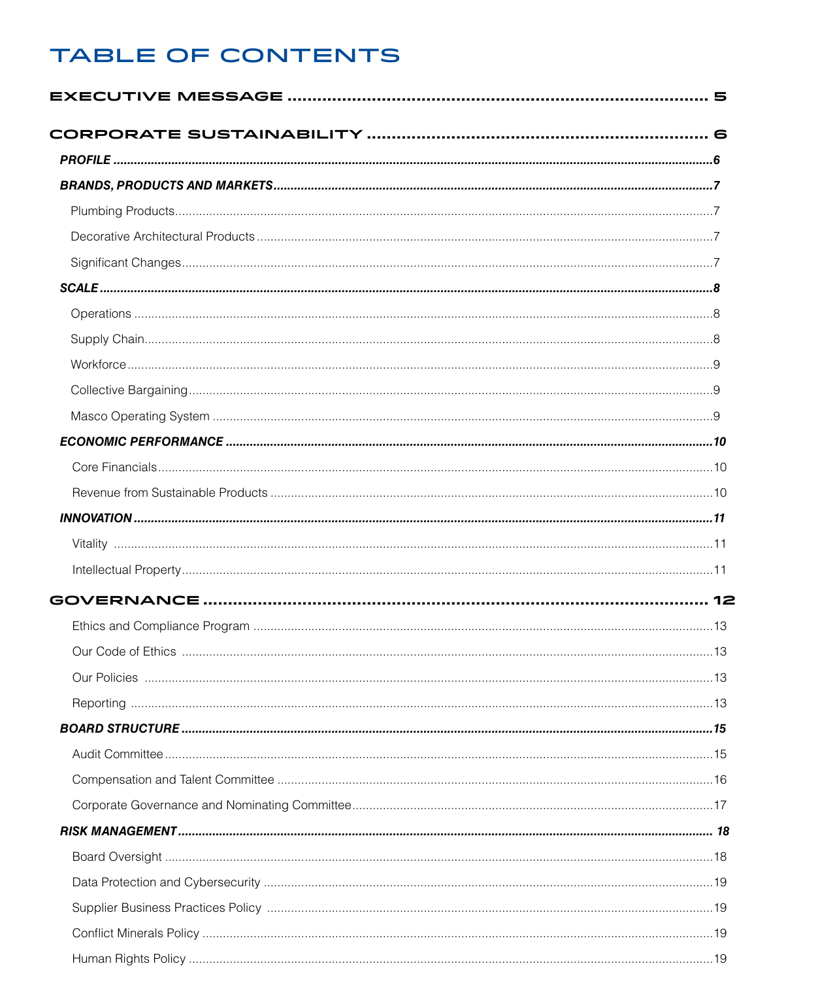


📄 Match 1 of 6 — Page 2 — Keyword: 'board oversight & sustainability'
💬 Enter your response:
  • A number or value (e.g. 3308) → to accept and save
  • 'n'                           → to skip this match
  • 'skip'                        → to stop reviewing matches and mark as 'N'
→ skip
🛑 Skipped by user. Setting value to 'N'.


In [ ]:
variable_name = "Board of Directors responsible for Environmental/Social performance"
keywords = {variable_name: [["board of directors", "environmental", "social", "performance"], ["board responsibility", "esg"], ["board oversight", "sustainability"], ["governance", "environmental", "social"], ["board level", "esg", "accountability"], ["ceo", "esg", "responsibility"], ["ceo", "sustainability", "oversight"], ["chief executive officer", "esg"], ["ceo", "accountable", "esg"]]}

semantic_results = semantic_variable_detection_all_reports(json_path, variable_name, keywords, threshold=0.5)
for r in semantic_results:
    print(f"{r['report']}: {r['decision']} (score={r['score']:.2f})")

general_variable_extraction(company_name, path, variable_name, keywords)

In [ ]:
variable_name = "Board compensation linked to Environmental/Social performance"
keywords = keywords = {variable_name: [["board compensation", "environmental performance"], ["board compensation", "social performance"], ["executive pay", "esg"], ["executive compensation", "sustainability goals"], ["incentive", "esg"], ["bonus", "sustainability targets"], ["ceo compensation", "esg performance"], ["remuneration", "climate goals"], ["performance-based pay", "environmental"], ["performance-based pay", "social"], ["board bonus", "esg"]]}

semantic_results = semantic_variable_detection_all_reports(company_name, variable_name, keywords, threshold=0.5)
for r in semantic_results:
    print(f"{r['report']}: {r['decision']} (score={r['score']:.2f})")

📄 Alleima_Governance_Report_2023.pdf: No keyword matches found.
📄 Alleima_Annual_Report_2023.pdf: No keyword matches found.
Alleima_Governance_Report_2023.pdf: NO (score=0.00)
Alleima_Annual_Report_2023.pdf: NO (score=0.00)


In [ ]:
variable_name = "Number of Employees (year end)"
keywords = {variable_name: [["number of employees"], ["total employees"], ["employee headcount"], ["number of staff"], ["total workforce"], ["total number of employees"], ["average number of employees"], ["employees at year end"], ["employees as of"], ["personnel count"] ]}

general_variable_extraction(company_name, path, variable_name, keywords, vertical_padding=130)


📘 Processing: integrated-annual-report-2023_eng.pdf

🔍 Variable: Total Salaries and Remuneration Expense (MEUR)
🔑 Keywords: ['['employee', 'compensation']' 17 match(es), '['salary', 'cost']' 3 match(es), '['salaries', 'remuneration', 'expense']' 3 match(es), '['wage', 'benefits', 'costs']' 1 match(es), '['personnel', 'expense']' 1 match(es)]
📌 Found 25 match(es) across pages.


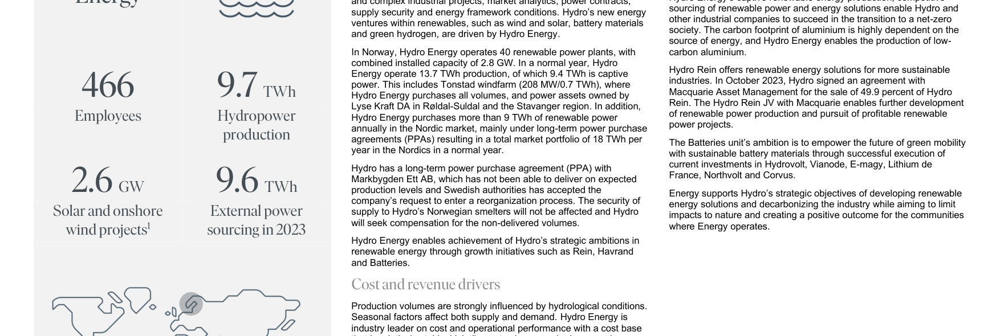


📄 Match 1 of 25 — Page 13 — Keyword: 'employee & compensation'
💬 Enter your response:
  • A number or value (e.g. 3308) → to accept and save
  • 'n'                           → to skip this match
  • 'skip'                        → to stop reviewing matches and mark as 'N'
→ skip
🛑 Skipped by user. Setting value to 'N'.


In [ ]:
variable_name = "Total salaries and remuneration expense (MEUR)"
keywords = {variable_name: [["salaries", "remuneration", "expense"], ["total payroll", "employees"], ["employee", "compensation"], ["wage", "benefits", "costs"], ["personnel", "expense"],["salary", "cost"]]}

general_variable_extraction(company_name, path, variable_name, keywords)


📘 Processing: integrated-annual-report-2023_eng.pdf

🔍 Variable: Reporting on Male/Female Pay Equality
🔑 Keywords: ['['reporting', 'gender', 'pay']' 4 match(es), '['gender pay gap']' 1 match(es), '['gender', 'remuneration', 'reporting']' 2 match(es)]
📌 Found 7 match(es) across pages.


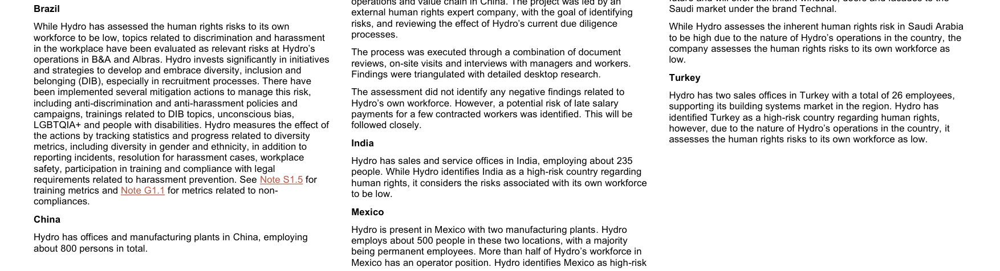


📄 Match 1 of 7 — Page 126 — Keyword: 'reporting & gender & pay'
💬 Enter your response:
  • A number or value (e.g. 3308) → to accept and save
  • 'n'                           → to skip this match
  • 'skip'                        → to stop reviewing matches and mark as 'N'
→ Y


In [ ]:
variable_name = "Reporting on male/female pay equality"
keywords = {variable_name: [["pay equality", "male", "female"], ["gender pay gap"], ["equal pay", "men", "women"], ["gender", "remuneration", "reporting"], ["male", "female", "salary", "comparison"], ["gender pay ratio"], ["reporting", "gender", "pay"]]}

semantic_results = semantic_variable_detection_all_reports(company_name, variable_name, keywords, threshold=0.5)
for r in semantic_results:
    print(f"{r['report']}: {r['decision']} (score={r['score']:.2f})")

general_variable_extraction(company_name, path, variable_name, keywords)

In [ ]:
variable_name = "Equal Opportunity Policy or Statement"
keywords = {variable_name: [["equal opportunity", "policy"], ["equal opportunity", "statement"], ["non-discrimination", "policy"], ["diversity", "equal opportunity"], ["equal employment", "statement"], ["commitment to", "equal opportunity"], ["fair treatment", "employees"], ["code of conduct", "equal opportunity"], ["equitable", "workplace"], "responsible employer"]}

semantic_results = semantic_variable_detection_all_reports(company_name, variable_name, keywords, threshold=0.15)
for r in semantic_results:
    print(f"{r['report']}: {r['decision']} (score={r['score']:.2f})")

general_variable_extraction(company_name, path, variable_name, keywords)



📘 Processing: Elkem_Annual_Report_2023.pdf

🔍 Variable: Board Size Including Employee Representatives
🔑 Keywords: ['board size' 0 match(es), '['number', 'board members']' 1 match(es)]
📌 Found 1 match(es) across pages.


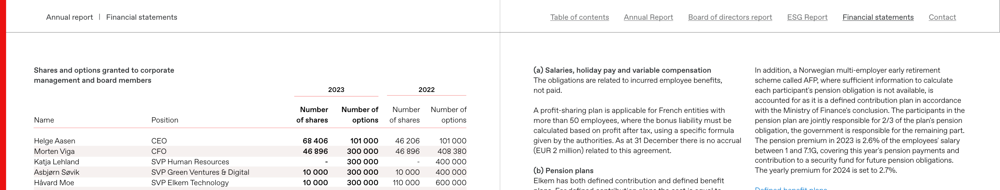


📄 Match 1 of 1 — Page 107 — Keyword: 'number & board members'
💬 Enter your response:
  • A number or value (e.g. 3308) → to accept and save
  • 'n'                           → to skip this match
  • 'skip'                        → to stop reviewing matches and mark as 'N'
→ 11

📘 Processing: Elkem_Sustainability_Report_2023.pdf

🔍 Variable: Board Size Including Employee Representatives
🔑 Keywords: ['board size' 0 match(es)]
📌 Found 0 match(es) across pages.
❌ No match accepted. Setting value to 'N'.


In [ ]:
variable_name = "Board Size including employee representatives"
keywords = {variable_name: ["board size", ["board size", "employee representatives"], ["number", "board members"], ["board of directors", "total members"], ["board composition", "employee"], ["number of directors", "including employee"], ["board size", "union"], ["board count", "employee representation"]]}

general_variable_extraction(company_name, path, variable_name, keywords)


📘 Processing: Elkem_Annual_Report_2023.pdf

🔍 Variable: Number of Full-Member Females on the Board
🔑 Keywords: ['['women', 'board']' 3 match(es), '['female', 'board']' 4 match(es)]
📌 Found 7 match(es) across pages.


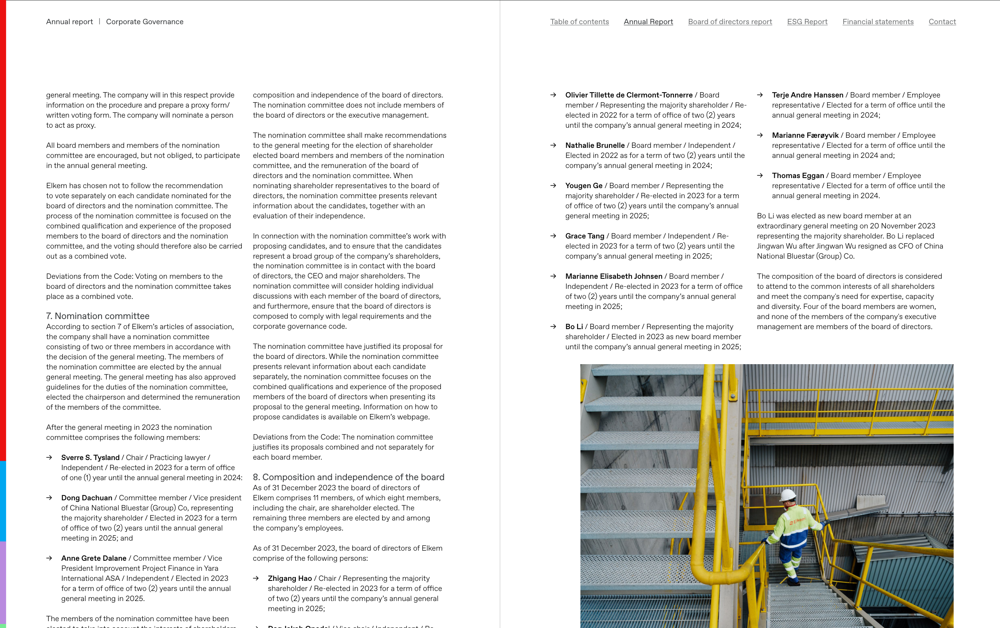


📄 Match 1 of 7 — Page 33 — Keyword: 'women & board'
💬 Enter your response:
  • A number or value (e.g. 3308) → to accept and save
  • 'n'                           → to skip this match
  • 'skip'                        → to stop reviewing matches and mark as 'N'
→ 3

📘 Processing: Elkem_Sustainability_Report_2023.pdf

🔍 Variable: Number of Full-Member Females on the Board
🔑 Keywords: ['['female', 'board']' 1 match(es)]
📌 Found 1 match(es) across pages.


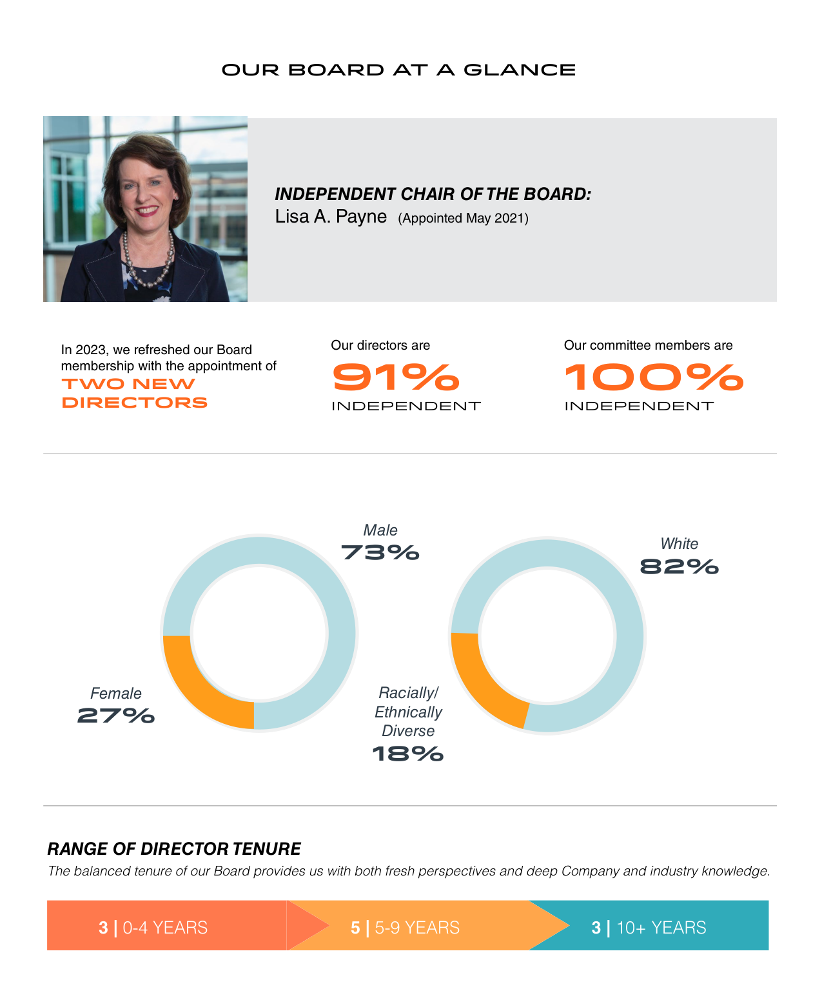


📄 Match 1 of 1 — Page 15 — Keyword: 'female & board'
💬 Enter your response:
  • A number or value (e.g. 3308) → to accept and save
  • 'n'                           → to skip this match
  • 'skip'                        → to stop reviewing matches and mark as 'N'
→ skip
🛑 Skipped by user. Setting value to 'N'.


In [ ]:
variable_name = "Number of full-member females on the Board"
keywords = {variable_name: [["female", "board members"], ["women on the board"], ["number of female", "directors"], ["female full members", "board"], ["gender", "board composition"], ["women", "board"], ["female", "board"],]}

general_variable_extraction(company_name, path, variable_name, keywords)


📘 Processing: Elkem_Annual_Report_2023.pdf

🔍 Variable: Number of Independent Directors
🔑 Keywords: ['['board', 'independent', 'members']' 4 match(es)]
📌 Found 4 match(es) across pages.


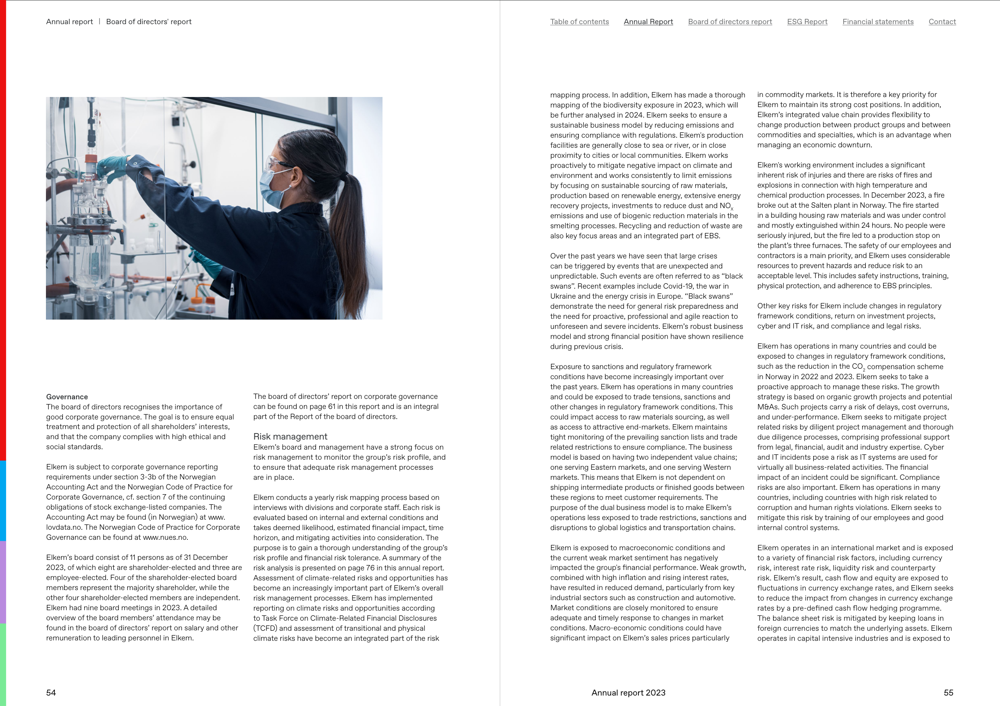


📄 Match 1 of 4 — Page 27 — Keyword: 'board & independent & members'
💬 Enter your response:
  • A number or value (e.g. 3308) → to accept and save
  • 'n'                           → to skip this match
  • 'skip'                        → to stop reviewing matches and mark as 'N'
→ 10

📘 Processing: Elkem_Sustainability_Report_2023.pdf

🔍 Variable: Number of Independent Directors
🔑 Keywords: ['['board', 'independent', 'members']' 3 match(es)]
📌 Found 3 match(es) across pages.


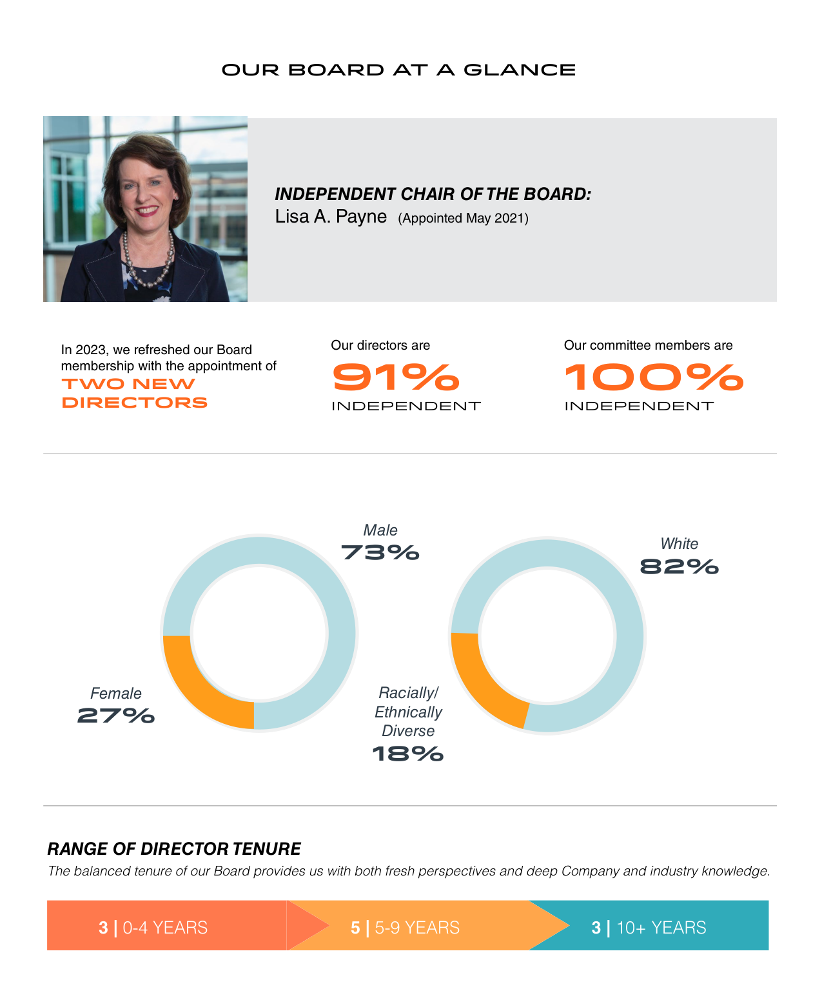


📄 Match 1 of 3 — Page 15 — Keyword: 'board & independent & members'
💬 Enter your response:
  • A number or value (e.g. 3308) → to accept and save
  • 'n'                           → to skip this match
  • 'skip'                        → to stop reviewing matches and mark as 'N'
→ skip
🛑 Skipped by user. Setting value to 'N'.


In [ ]:
variable_name = "Number of Independent Directors"
keywords = {variable_name: [["independent directors"], ["number of independent", "board members"], ["outside directors"], ["board", "independent", "members"], ["board composition", "independent"], ["independent board", "count"]]}

general_variable_extraction(company_name, path, variable_name, keywords)



📘 Processing: Elkem_Annual_Report_2023.pdf

🔍 Variable: Number of Board Meetings Held Last Year
🔑 Keywords: ['['board meetings', 'year']' 3 match(es), '['board meetings', 'held']' 1 match(es)]
📌 Found 4 match(es) across pages.


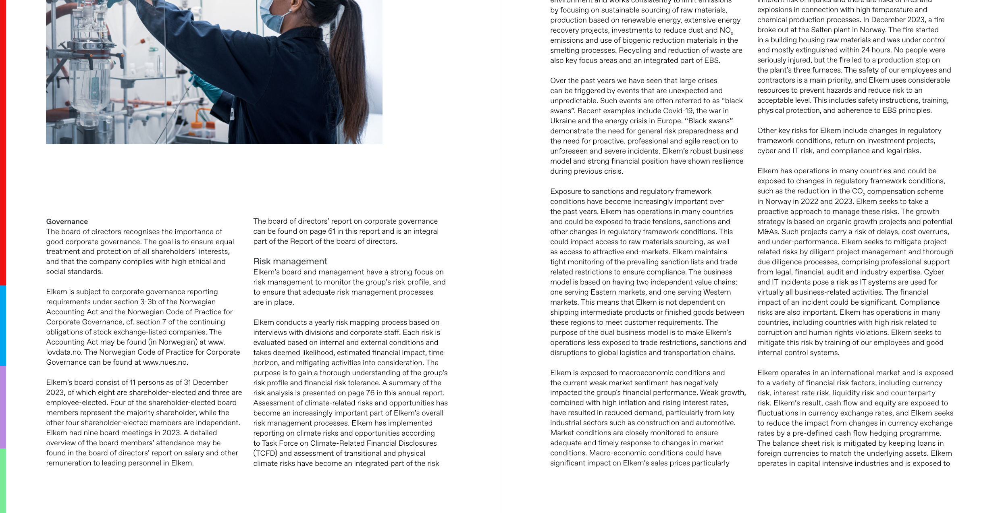


📄 Match 1 of 4 — Page 27 — Keyword: 'board meetings & year'
💬 Enter your response:
  • A number or value (e.g. 3308) → to accept and save
  • 'n'                           → to skip this match
  • 'skip'                        → to stop reviewing matches and mark as 'N'
→ 9

📘 Processing: Elkem_Sustainability_Report_2023.pdf

🔍 Variable: Number of Board Meetings Held Last Year
🔑 Keywords: []
📌 Found 0 match(es) across pages.
❌ No match accepted. Setting value to 'N'.


In [ ]:
variable_name = "Board Meetings Per Year"
keywords = {variable_name: [["board meetings", "held"], ["number of", "board meetings"], ["meetings of the board", "past year"], ["board meetings", "year"], ["number", "board meetings"]]}

general_variable_extraction(company_name, path, variable_name, keywords)


📘 Processing: Elkem_Annual_Report_2023.pdf

🔍 Variable: Earnings Per Share Diluted (EUR)
🔑 Keywords: ['['earnings per share', 'diluted']' 2 match(es)]
📌 Found 2 match(es) across pages.


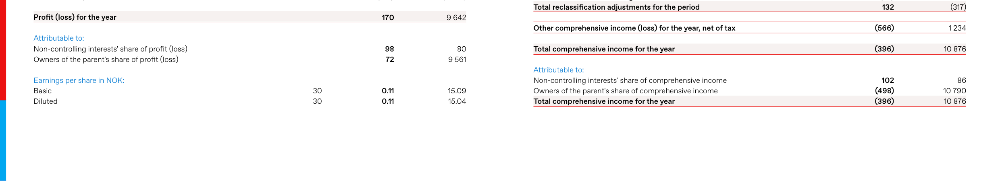


📄 Match 1 of 2 — Page 92 — Keyword: 'earnings per share & diluted'
💬 Enter your response:
  • A number or value (e.g. 3308) → to accept and save
  • 'n'                           → to skip this match
  • 'skip'                        → to stop reviewing matches and mark as 'N'
→ 0.11

📘 Processing: Elkem_Sustainability_Report_2023.pdf

🔍 Variable: Earnings Per Share Diluted (EUR)
🔑 Keywords: []
📌 Found 0 match(es) across pages.
❌ No match accepted. Setting value to 'N'.


In [ ]:
variable_name = "Earnings Per Share diluted (EUR)"
keywords = {variable_name: [["earnings per share", "diluted"], ["diluted eps", "eur"], ["after-tax", "eps"], ["eps of continued operations"], ["earnings per share", "continued operations"]]}

general_variable_extraction(company_name, path, variable_name, keywords)


In [ ]:
variable_name = "Block shareholders voting power %"
keywords = {variable_name: [["block shareholders", "voting power"], ["voting power", "ownership", "over 5%"], ["ownership", "more than 5%", "voting"], ["large shareholders", "voting percentage"], ["block ownership", "voting rights"]]}

general_variable_extraction(company_name, path, variable_name, keywords)



📘 Processing: Elkem_Annual_Report_2023.pdf

🔍 Variable: Block Shareholders Voting Power %
🔑 Keywords: []
📌 Found 0 match(es) across pages.
❌ No match accepted. Setting value to 'N'.

📘 Processing: Elkem_Sustainability_Report_2023.pdf

🔍 Variable: Block Shareholders Voting Power %
🔑 Keywords: []
📌 Found 0 match(es) across pages.
❌ No match accepted. Setting value to 'N'.


In [ ]:
variable_name = "CEO fixed salary"
keywords = {variable_name: ["ceo fixed salary", "ceo base salary", "ceo fixed remuneration", "ceo base pay", "ceo annual salary", "ceo salary", "ceo gross salary", "ceo compensation fixed", ["ceo", "fixed", "salary"], ["ceo", "base", "salary"], ["ceo", "fixed", "remuneration"], ["ceo", "base", "pay"], ["chief executive", "salary"], ["executive", "fixed", "salary"], ["ceo", "annual", "salary"], ["ceo", "fixed", "compensation"], ["ceo", "remuneration", "fixed"], ["executive", "remuneration", "management"]]}

general_variable_extraction(company_name, path, variable_name, keywords)

In [ ]:
variable_name = "CEO variable salary/cash bonus"
keywords= {variable_name: [ "ceo variable salary", "ceo bonus", "ceo variable pay", "ceo variable compensation", "ceo incentive", "ceo incentive pay", "ceo performance bonus", "ceo cash bonus", "ceo short-term incentive", "ceo sti bonus", ["ceo", "bonus"], ["ceo", "variable", "pay"], ["ceo", "performance", "bonus"], ["ceo", "cash", "bonus"], ["ceo", "incentive", "compensation"], ["ceo", "short-term", "incentive"]]}

general_variable_extraction(company_name, path, variable_name, keywords, vertical_padding=130)

In [ ]:
variable_name = "CEO LTI/share-based award"
keywords = {variable_name: ["vested interest", "share-based", ["ceo", "award"],  ["ceo", "award"]]}

general_variable_extraction(company_name, path, variable_name, keywords)

In [ ]:
variable_name = "CEO pension and other social security contributions"
keywords = {variable_name: ["ceo pension", "ceo retirement contributions", "ceo social security contributions","ceo post-employment benefits", "ceo pension expense",  "ceo pension cost", "ceo defined benefit plan", "ceo defined contribution plan", ["ceo", "pension"], ["ceo", "social", "security"], ["ceo", "retirement", "benefit"], ["ceo", "social", "charges"], ["ceo", "post", "employment"]]}

general_variable_extraction(company_name, path, variable_name, keywords)

In [ ]:
variable_name = "CEO other comp."
keywords = {variable_name: [ "ceo other compensation","ceo other comp", "ceo other benefits", "ceo fringe benefits","ceo additional compensation", "ceo perquisites", "ceo perks", "ceo non-monetary compensation", ["ceo", "other", "compensation"], ["ceo", "other", "benefits"], ["ceo", "fringe", "benefits"], ["ceo", "travel", "expenses"], ["ceo", "rental", "costs"], ["ceo", "additional", "compensation"], ["ceo", "perks"]]}

general_variable_extraction(company_name, path, variable_name, keywords)

In [ ]:
variables_to_convert = ['Sales (MEUR 20xx YE)', 'Total salaries and remuneration expense (MEUR)', 'Earnings Per Share diluted (EUR)',  'CEO fixed salary', 'CEO variable salary/cash bonus', 'CEO LTI/share-based award', 'CEO pension and other social security contributions', 'CEO other comp.']

convert_currency_columns_to_eur(excel_path="Reports/template_answer.xlsx",sheet_name="DataCollectionSheet",
    variables=variables_to_convert, save_as="Reports/resulst_table.xlsx")

⚠️ Column 'Total salaries and remuneration expense (MEUR)' not found. Skipping.
❌ Error converting at row 6, var 'CEO fixed salary': could not convert string to float: 'ND'
❌ Error converting at row 11, var 'CEO fixed salary': could not convert string to float: 'ND'
❌ Error converting at row 6, var 'CEO variable salary/cash bonus': could not convert string to float: 'ND'
❌ Error converting at row 11, var 'CEO variable salary/cash bonus': could not convert string to float: 'ND'
❌ Error converting at row 6, var 'CEO LTI/share-based award': could not convert string to float: 'ND'
❌ Error converting at row 11, var 'CEO LTI/share-based award': could not convert string to float: 'ND'
❌ Error converting at row 6, var 'CEO pension and other social security contributions': could not convert string to float: 'ND'
❌ Error converting at row 9, var 'CEO pension and other social security contributions': could not convert string to float: 'ND'
❌ Error converting at row 11, var 'CEO pension and other 

,Finbas,Data point name:,"Reporting year\nThe year for which data that should be collected is reported. Reporting year 2017 data is published in the 2018 report, etc.",Reported Currency,Sales (MEUR 20xx YE),Targets associated with Environmental Performance,Total Energy Consumption (GJ),Disclosure of raw material consumption,Targets associated with Efficient use of Resources,Total Scope 1 and Scope 2 Emissions (kilotonnes),...,Number of full-member females on the Board,Number of Independent Directors,Board Meetings Per Year,Earnings Per Share diluted (EUR),Block shareholders voting power %,CEO fixed salary,CEO variable salary/cash bonus,CEO LTI/share-based award,CEO pension and other social security contributions,CEO other comp.
0,NaN,Valid Inputs:,2021.0,CCC,Value / ND,Y / N,Value / ND,Y / N,Y / N,Value / ND,...,Value / ND,Value / ND,Value / ND,Value / ND,Value / ND,Value / ND,Value / ND,Value / ND,Value / ND,Value / ND
1,NaN,Example:,2021.0,SEK,11.19,Y,44.442,Y,Y,60,...,3,6,5,0.01,0.33,0.02,0.01,0.02,0.0,0.0
2,NaN,Company Name,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,Your input below this row,NaN,NaN,Your input below this row,NaN,NaN,NaN,NaN
3,NaN,GreenMobility A/S,2023.0,DKK,1.7,Y,12180.636,N,N,0.57222,...,1,3,5,-0.33,0.616,0.02,0.0,0.01,0.0,0.0
4,NaN,Alleima,2023.0,SEK,187.4,Y,3729000,Y,N,147,...,1,5,15,0.06,0.2852,0.06,0.02,0.0,0.02,0.0
5,43900.0,Boliden AB,2023.0,SEK,712.24,Y,21085000,Y,Y,843,...,3,7,14,0.2,0.054,0.09,0.0,0.0,0.03,0.0
6,78200.0,Elkem ASA,2023.0,NOK,354.63,Y,26172000,N,Y,3040,...,4,4,9,0.0,0.529,ND,ND,ND,ND,ND
7,127.0,Holmen AB,2023.0,SEK,206.68,Y,29142000,Y,Y,66,...,4,8,11,0.21,0.802,0.1,0.05,0.0,0.06,0.0
8,66140.0,HEXPOL AB,2023.0,SEK,199.89,Y,136029.403923,Y,N,117.75,...,3,4,10,0.07,0.572,0.13,0.15,0.0,0.05,0.04
9,1612.0,Kemira Oyj,2023.0,EUR,3383.7,Y,13251600,Y,Y,780,...,3,7,13,1.28,0.266,0.99,0.74,3.49,ND,ND
